# Infer posterior Distribution of Pooled Parameters for Lung Cancer Medium Erlotinib Dose Group

## Show data

In [1]:
import erlotinib as erlo

# Get data
data = erlo.DataLibrary().lung_cancer_high_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

**Figure 1:** Visualisation of the measured plasma concentration and tumour volumes in 8 mice with patient-derived lung cancer implants.

## Build model

In [2]:
# Define mechanistic model
path = erlo.ModelLibrary().erlotinib_tumour_growth_inhibition_model()
mechanistic_model = erlo.PharmacokineticModel(path)
mechanistic_model.set_administration(compartment='central', direct=False)
mechanistic_model.set_parameter_names(names={
    'central.drug_amount': 'Initial plasma drug amount in mg',
    'dose.drug_amount': 'Initial dose comp. drug amount in mg',
    'central.size': 'Volume of distribution in L',
    'dose.absorption_rate': 'Absorption rate in 1/d',
    'myokit.elimination_rate': 'Elimination rate in 1/d',
    'myokit.tumour_volume': 'Initial tumour volume in cm^3',
    'myokit.critical_volume': 'Critical volume in cm^3',
    'myokit.kappa': 'Potency in L/mg/day',
    'myokit.lambda': 'Exponential growth rate in 1/day'})
mechanistic_model.set_outputs([
    'central.drug_concentration',
    'myokit.tumour_volume'])
mechanistic_model.set_output_names({
    'central.drug_concentration': 'Plasma conc. in ng/mL',
    'myokit.tumour_volume': 'Tumour volume in cm^3'})

# Define error model
error_models = [
    erlo.ConstantAndMultiplicativeGaussianErrorModel(),  # Plasma conc.
    erlo.ConstantAndMultiplicativeGaussianErrorModel()]  # Tumour volume

# Define population model
population_models = [
    erlo.PooledModel(),  # Initial tumour volume
    erlo.PooledModel(),  # Volume of distribution
    erlo.PooledModel(),  # Absorption rate
    erlo.PooledModel(),  # Critical volume
    erlo.PooledModel(),  # Elimination rate
    erlo.PooledModel(),  # Potency
    erlo.PooledModel(),  # Growth rate
    erlo.PooledModel(),  # Plasma conc. Sigma base
    erlo.PooledModel(),  # Plasma conc. Sigma rel.
    erlo.PooledModel(),  # Tumour volume Sigma base
    erlo.PooledModel()]  # Tumour volume Sigma rel.

# Compose model and not identified parameters
problem = erlo.ProblemModellingController(mechanistic_model, error_models)
problem.fix_parameters({
    'Initial plasma drug amount in mg': 0,
    'Initial dose comp. drug amount in mg': 0})
problem.set_population_model(population_models)

## Prior Predictive Check

In [3]:
import numpy as np
import pints

# Define prior distribution
log_priors = [
    pints.TruncatedGaussianLogPrior(mean=0.25, sd=0.1, a=0, b=np.inf),   # Initial tumour volume
    pints.TruncatedGaussianLogPrior(mean=0.02, sd=0.02, a=0, b=np.inf),  # Volume of distribution
    pints.TruncatedGaussianLogPrior(mean=55, sd=25, a=0, b=np.inf),      # Absorption rate
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Critical volume
    pints.TruncatedGaussianLogPrior(mean=10, sd=5, a=0, b=np.inf),       # Elimination rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf),    # Potency
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf),    # Growth rate
    pints.TruncatedGaussianLogPrior(mean=0, sd=0.1, a=0, b=np.inf),      # Plasma conc. Sigma base
    pints.TruncatedGaussianLogPrior(mean=0, sd=1, a=0, b=np.inf),        # Plasma conc. Sigma rel.
    pints.TruncatedGaussianLogPrior(mean=0, sd=0.1, a=0, b=np.inf),      # Tumour volume Sigma base
    pints.TruncatedGaussianLogPrior(mean=0, sd=1, a=0, b=np.inf)]        # Tumour volume Sigma rel.
log_prior = pints.ComposedLogPrior(*log_priors)

# Compose prior predictive model
predictive_model = problem.get_predictive_model(exclude_pop_model=True)
prior_predictive_model = erlo.PriorPredictiveModel(
    predictive_model, log_prior)
prior_predictive_model.set_dosing_regimen(dose=2.5, start=3, period=1, num=14)

# Sample from prior predictive model
times = np.linspace(0, 30, num=200)
n_samples = 1000
samples = prior_predictive_model.sample(times, n_samples)

# Illustrate prior predictive model
fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, biomarker='Plasma conc. in ng/mL', bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, biomarker='Tumour volume in cm^3', bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

**Figure 2:** Prior predictive model of tumour volume measurement over time. The shaded areas estimate the 0.3, 0.6 and 0.9 bulk probability of the prior predictive distribution by sampling 1000 virtual "measurements" at each of the 50 equidistant time points.

## Find posterior probability distribution

In [4]:
# Create log-posteriors
problem.set_data(data, 
    output_biomarker_dict={
        'Plasma conc. in ng/mL': 'Plasma concentration',
        'Tumour volume in cm^3': 'Tumour volume'})
problem.set_log_prior(log_priors)
log_posterior = problem.get_log_posterior()

# Set up sampling controller
sampler = erlo.SamplingController(log_posterior)
sampler.set_transform(transform=pints.LogTransformation(n_parameters=problem.get_n_parameters()))
sampler.set_n_runs(5)

# Run sampling
n_iterations = 60000
posterior_samples = sampler.run(n_iterations=n_iterations, show_progress_bar=True)

## Find hyperparameters for good convergence

### Pooled

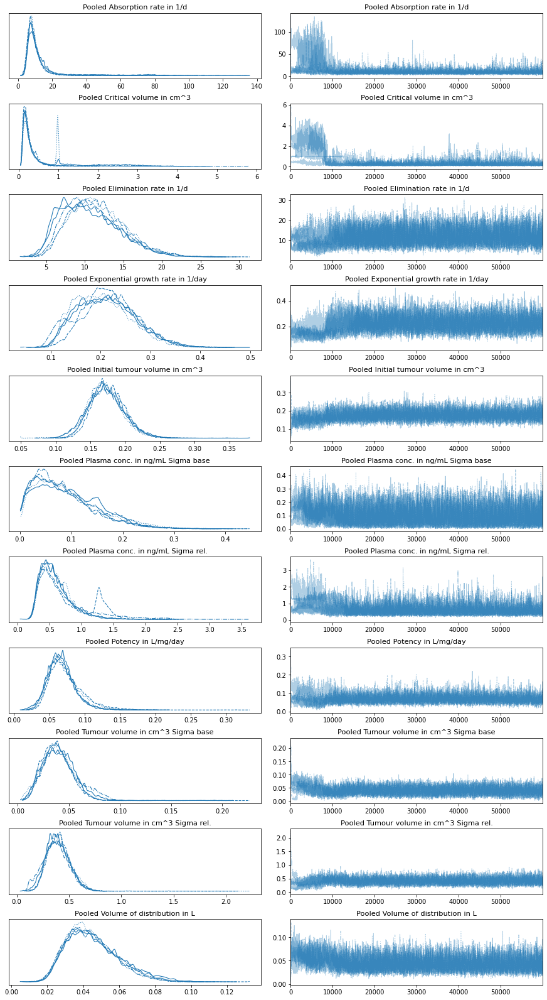

In [5]:
import arviz as az
import matplotlib.pyplot as plt

az.plot_trace(posterior_samples)
plt.show()

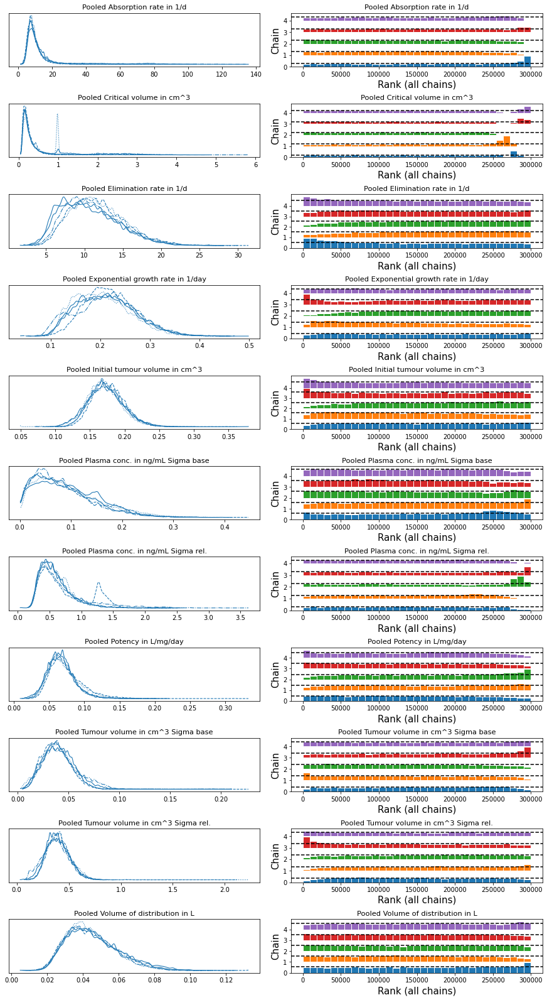

In [6]:
az.plot_trace(posterior_samples, kind='rank_bars')
plt.show()

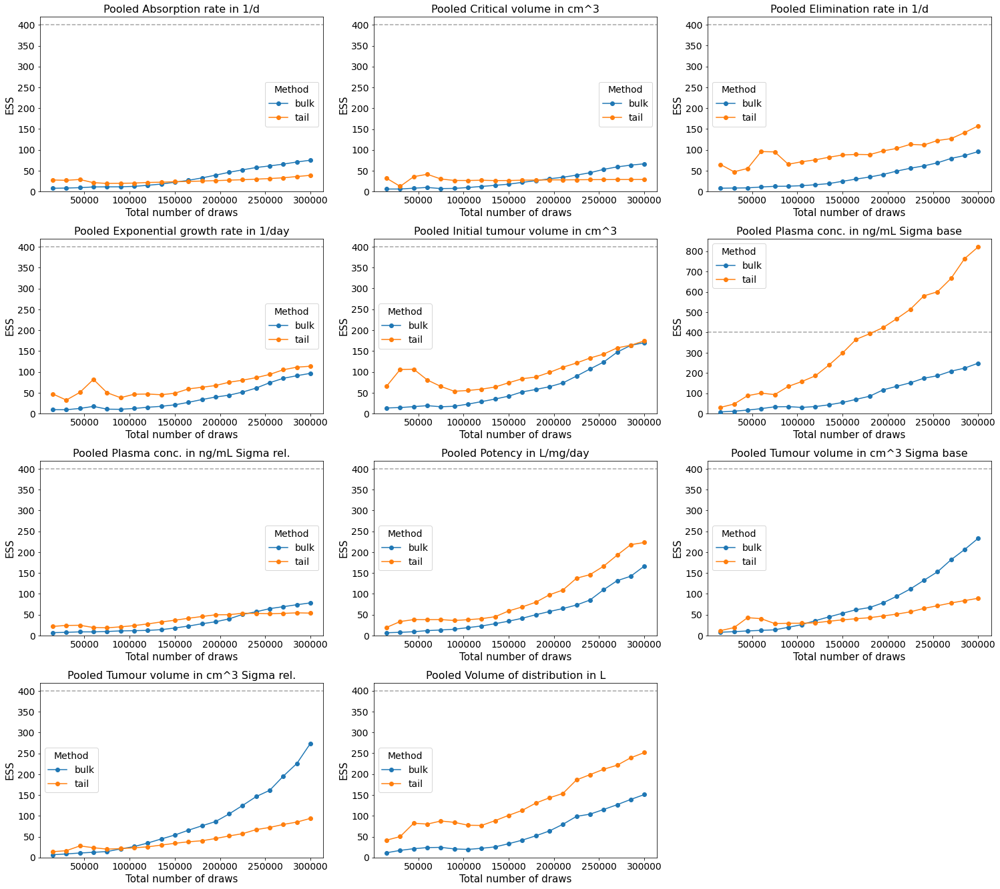

In [7]:
az.plot_ess(posterior_samples, kind="evolution")
plt.show()

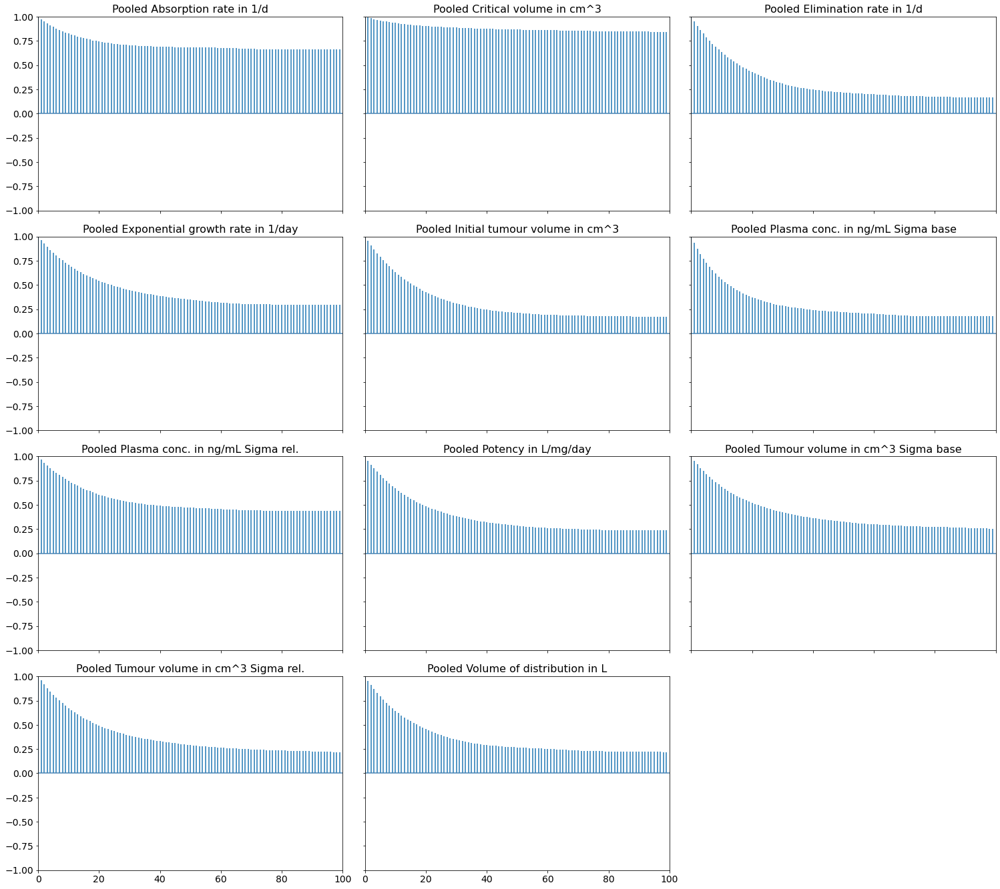

In [8]:
az.plot_autocorr(posterior_samples, combined=True)
plt.show()

### Exclude warmup

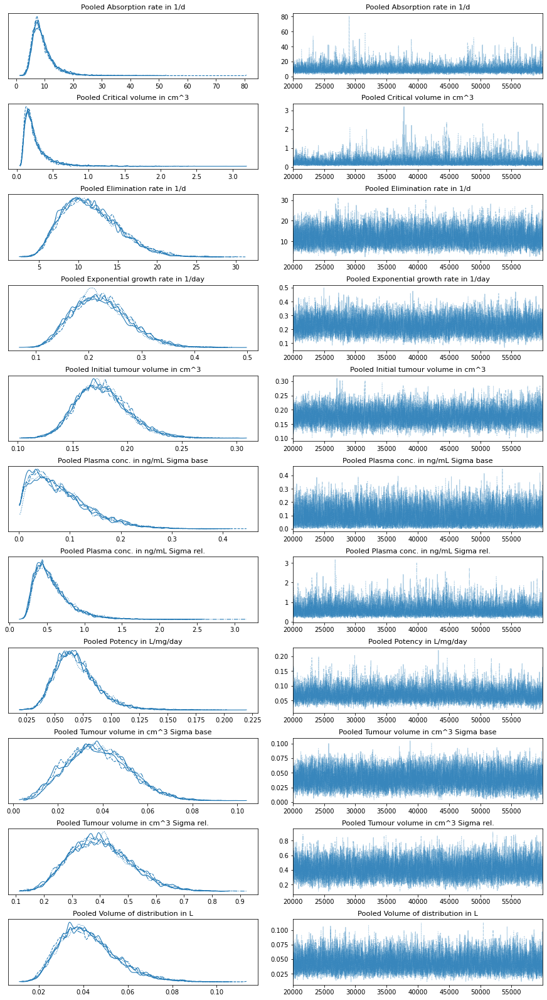

In [9]:
warmup = 20000

az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations)))
plt.show()

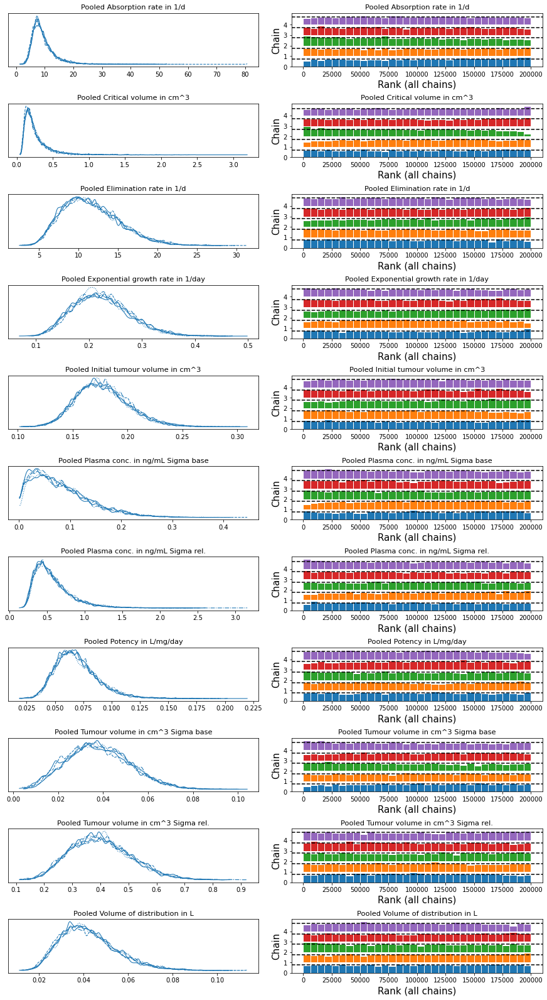

In [10]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations)), kind='rank_bars')
plt.show()

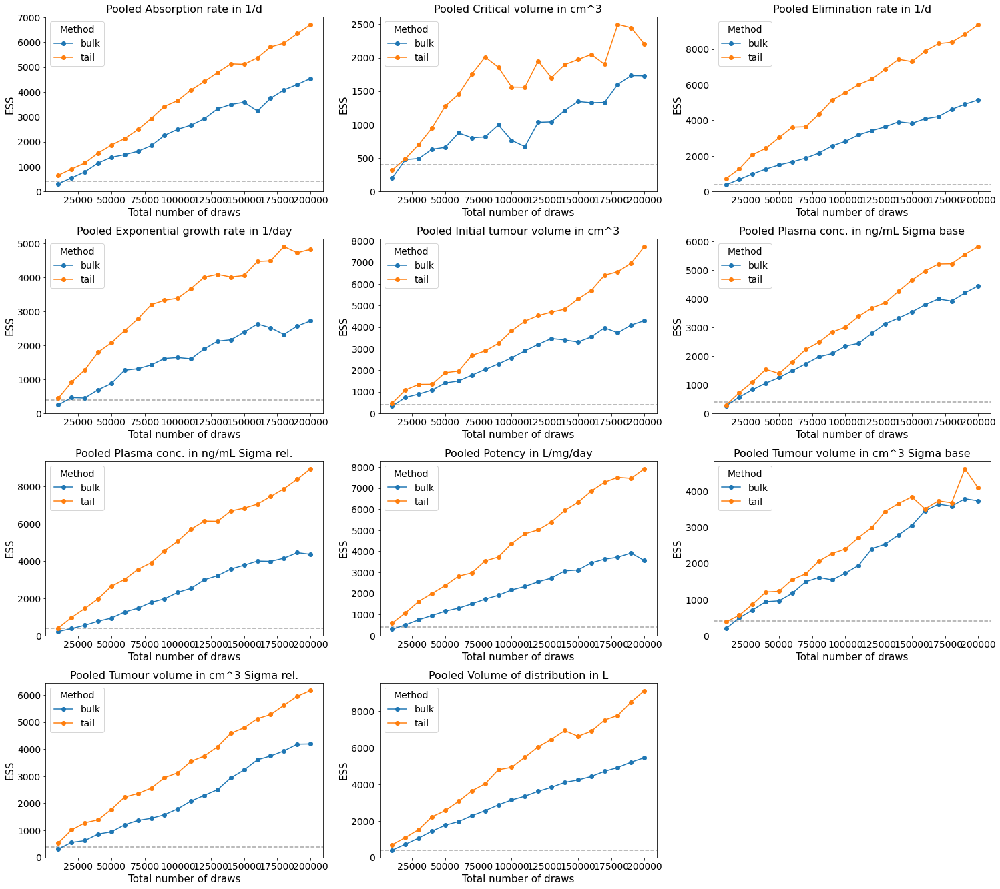

In [11]:
az.plot_ess(posterior_samples.sel(draw=slice(warmup, n_iterations)), kind="evolution")
plt.show()

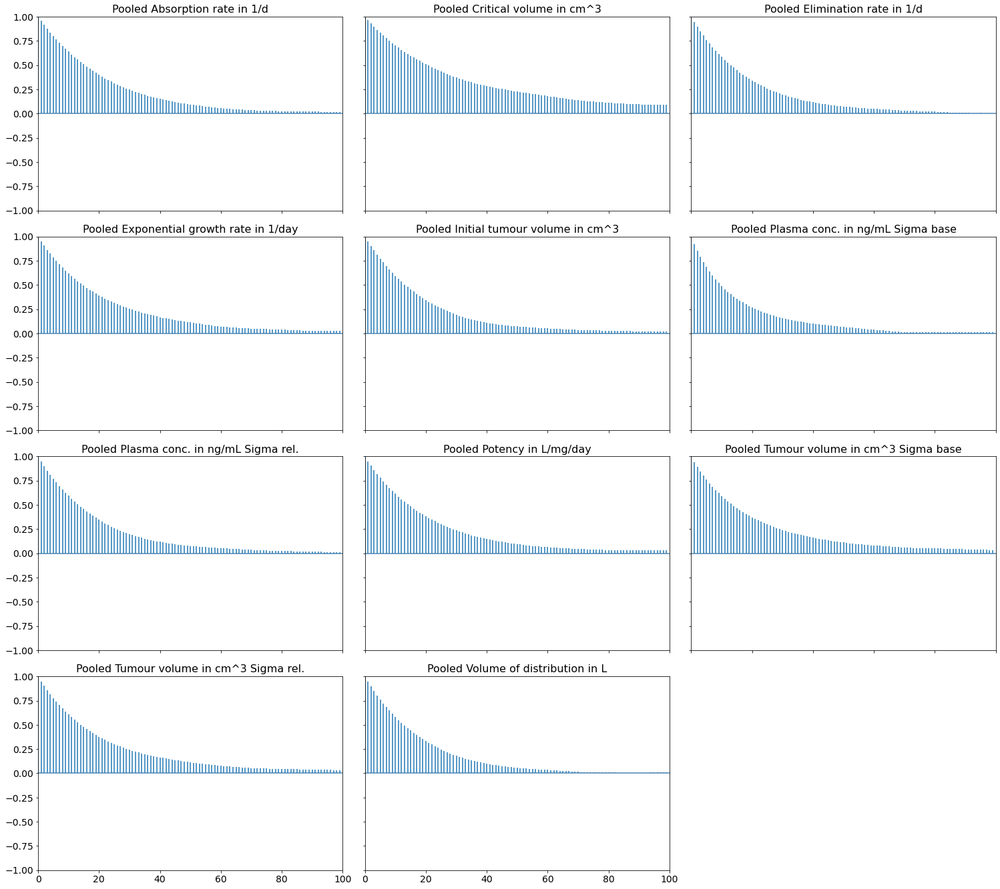

In [12]:
az.plot_autocorr(posterior_samples.sel(draw=slice(warmup, n_iterations)), combined=True)
plt.show()

### Reduce correlations by thinning out

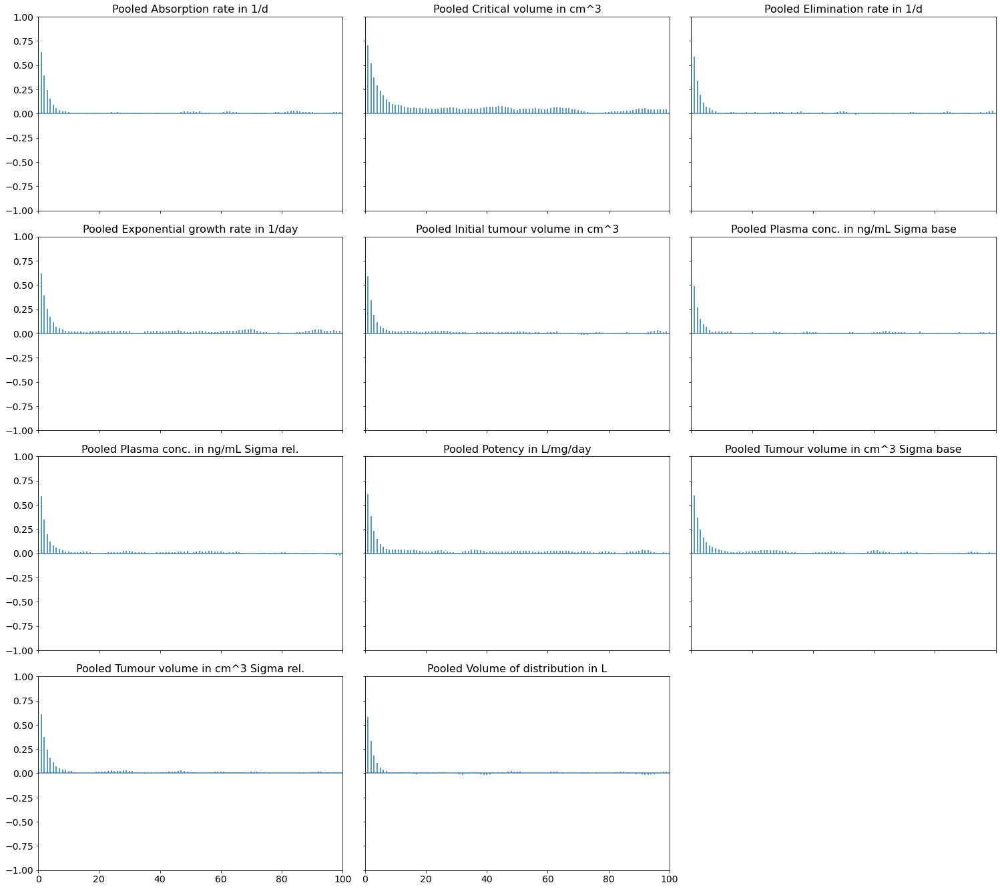

In [13]:
thinning_ratio = 10

az.plot_autocorr(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), combined=True)
plt.show()

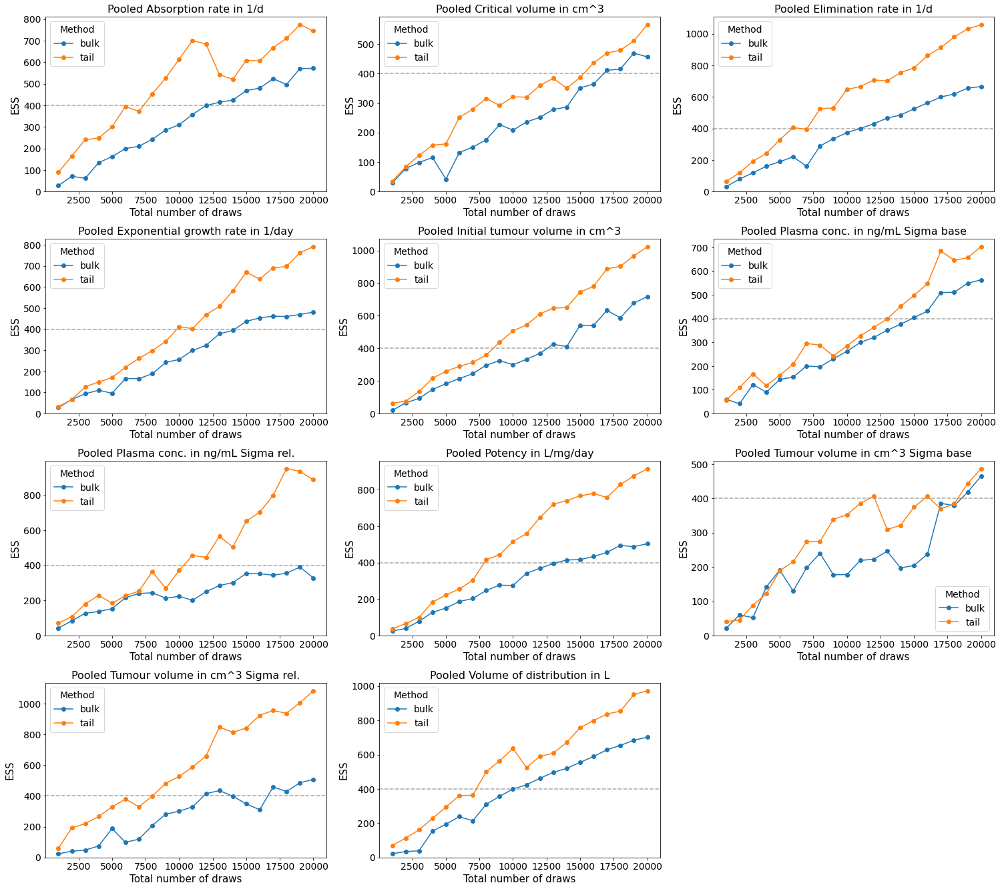

In [14]:
az.plot_ess(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), kind="evolution")
plt.show()

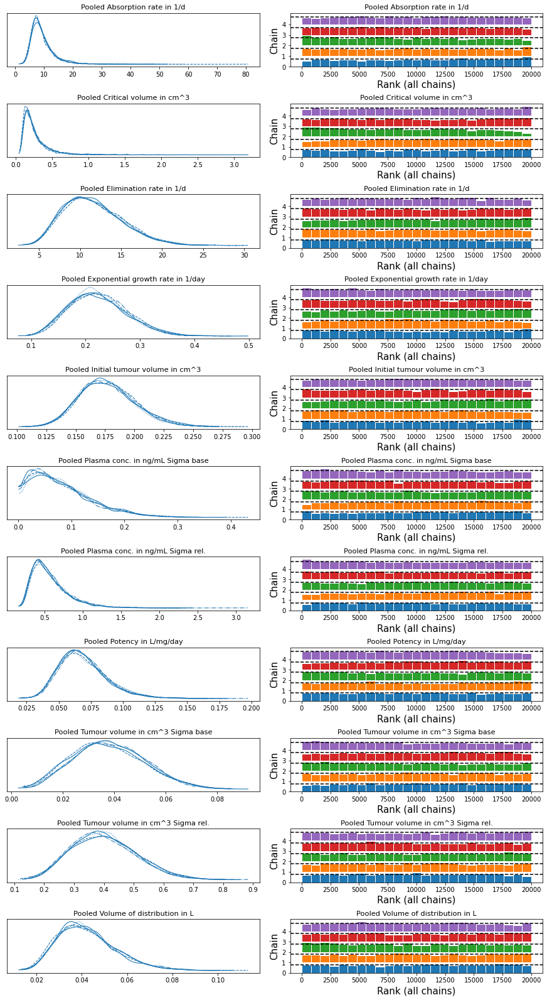

In [15]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), kind='rank_bars')
plt.show()

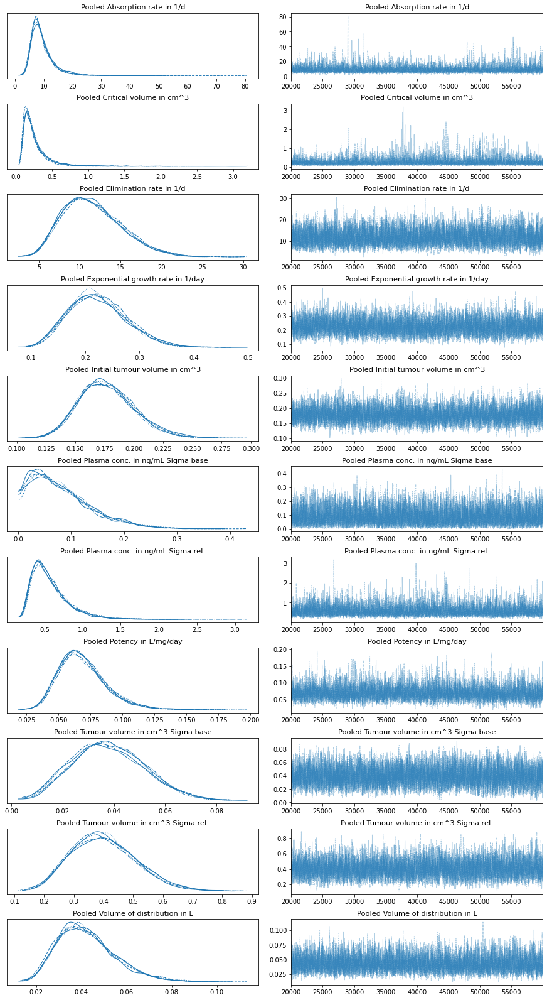

In [16]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)))
plt.show()

## Save posterior

In [17]:
import os

# Rename parameters (for export)
temp = posterior_samples.rename({
    'Pooled Initial tumour volume in cm^3': 'pooled_initial_tumour_volume',
    'Pooled Critical volume in cm^3': 'pooled_critical_volume',
    'Pooled Exponential growth rate in 1/day': 'pooled_growth_rate',
    'Pooled Plasma conc. in ng/mL Sigma base': 'pooled_plasma_concentration_sigma_base',
    'Pooled Plasma conc. in ng/mL Sigma rel.': 'pooled_plasma_concentration_sigma_rel',
    'Pooled Absorption rate in 1/d': 'pooled_absorption_rate',
    'Pooled Volume of distribution in L': 'pooled_volume_distribution',
    'Pooled Elimination rate in 1/d': 'pooled_elimination_rate',
    'Pooled Potency in L/mg/day': 'pooled_potency',
    'Pooled Tumour volume in cm^3 Sigma base': 'pooled_tumour_volume_sigma_base',
    'Pooled Tumour volume in cm^3 Sigma rel.': 'pooled_tumour_volume_sigma_rel'})

# Export samples
directory = os.getcwd()
name = '/posteriors/pooled.nc'
temp.sel(draw=slice(warmup, n_iterations, thinning_ratio)).to_netcdf(directory + name)